<a href="https://colab.research.google.com/github/dikshasinghhh/Play-Vision/blob/main/Obejct_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.3/41.3 kB 2.0 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.

# Importing the Libraries

In [ ]:
import os
import shutil
import random

!pip install tqdm --upgrade
from tqdm.notebook import tqdm

# Connecting to Google drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Creating path for folders

In [ ]:
train_path_img = "./yolo_data/images/train/"
train_path_label = "./yolo_data/labels/train/"
val_path_img = "./yolo_data/images/val/"
val_path_label = "./yolo_data/labels/val/"
test_path = "./yolo_data/test"

# Splitting the data set into Training set and Test set

In [ ]:
def train_test_split(path,neg_path=None, split = 0.2):
    print("------ PROCESS STARTED -------")


    files = list(set([name[:-4] for name in os.listdir(path)])) ## removing duplicate names i.e. counting only number of images


    print (f"--- This folder has a total number of {len(files)} images---")
    random.seed(42)
    random.shuffle(files)

    test_size = int(len(files) * split)
    train_size = len(files) - test_size

    ## creating required directories

    os.makedirs(train_path_img, exist_ok = True)
    os.makedirs(train_path_label, exist_ok = True)
    os.makedirs(val_path_img, exist_ok = True)
    os.makedirs(val_path_label, exist_ok = True)


    ### ----------- copying images to train folder
    for filex in tqdm(files[:train_size]):
      if filex == 'classes':
          continue
      shutil.copy2(path + filex + '.jpg',f"{train_path_img}/" + filex + '.jpg' )
      shutil.copy2(path + filex + '.txt', f"{train_path_label}/" + filex + '.txt')



    print(f"------ Training data created with 80% split {len(files[:train_size])} images -------")

    if neg_path:
        neg_images = list(set([name[:-4] for name in os.listdir(neg_path)])) ## removing duplicate names i.e. counting only number of images
        for filex in tqdm(neg_images):
            shutil.copy2(neg_path+filex+ ".jpg", f"{train_path_img}/" + filex + '.jpg')

        print(f"------ Total  {len(neg_images)} negative images added to the training data -------")

        print(f"------ TOTAL Training data created with {len(files[:train_size]) + len(neg_images)} images -------")



    ### copytin images to validation folder
    for filex in tqdm(files[train_size:]):
      if filex == 'classes':
          continue
      # print("running")
      shutil.copy2(path + filex + '.jpg', f"{val_path_img}/" + filex + '.jpg' )
      shutil.copy2(path + filex + '.txt', f"{val_path_label}/" + filex + '.txt')

    print(f"------ Testing data created with a total of {len(files[train_size:])} images ----------")

    print("------ TASK COMPLETED -------")

## spliting the data into train-test and creating train.txt and test.txt files
# train_test_split('/content/drive/MyDrive/custom_notebooks/yolo_data/')

### for label_tag
train_test_split('/content/drive/MyDrive/yolov8/data/') ### without negative images
# train_test_split('./data/','./negative_images/') ### if you want to feed negative images

------ PROCESS STARTED -------
--- This folder has a total number of 66 images---


  0%|          | 0/53 [00:00<?, ?it/s]

------ Training data created with 80% split 53 images -------


  0%|          | 0/13 [00:00<?, ?it/s]

------ Testing data created with a total of 13 images ----------
------ TASK COMPLETED -------


# .yaml file

In [ ]:
!head '/content/drive/MyDrive/yolov8/dataset.yaml'

# Train/val/test sets as 
## 1) dir: path/to/imgs, 2) file: path/to/imgs.txt, or 3) list: [path/to/imgs1, path/to/imgs2, ..]


#path: ../datasets/coco128  # dataset root dir
train: /content/yolo_data/images/train  # train images (relative to 'path') 128 images
val: /content/yolo_data/images/val # val images (relative to 'path') 128 images
# test:  # test images (optional)

# Classes


# The Environemnt/Version

In [ ]:
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.2.75 🚀 Python-3.10.12 torch-2.3.1+cu121 CPU (Intel Xeon 2.20GHz)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 33.7/107.7 GB disk)


# Training the model

In [ ]:
!yolo task=detect mode=train model=yolov8s.pt data=/content/drive/MyDrive/yolov8/dataset.yaml epochs=10 imgsz=640 batch=8 project=/content/drive/MyDrive/yolov8/training_results name=football

100% 21.5M/21.5M [00:00<00:00, 90.2MB/s]
Ultralytics YOLOv8.2.75 🚀 Python-3.10.12 torch-2.3.1+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/drive/MyDrive/yolov8/dataset.yaml, epochs=10, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/yolov8/training_results, name=football4, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_fram

# Detection on Images

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/yolov8/training_results/football/weights/best.pt conf=0.55 source=/content/drive/MyDrive/yolov8/test_images

Ultralytics YOLOv8.2.75 🚀 Python-3.10.12 torch-2.3.1+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 11,126,358 parameters, 0 gradients, 28.4 GFLOPs

image 1/9 /content/drive/MyDrive/yolov8/test_images/100.png: 384x640 15 players, 407.5ms
image 2/9 /content/drive/MyDrive/yolov8/test_images/10011.png: 384x640 15 players, 736.1ms
image 3/9 /content/drive/MyDrive/yolov8/test_images/10014.png: 384x640 10 players, 1 football, 605.5ms
image 4/9 /content/drive/MyDrive/yolov8/test_images/10016.png: 384x640 15 players, 394.2ms
image 5/9 /content/drive/MyDrive/yolov8/test_images/10018.png: 384x640 12 players, 378.8ms
image 6/9 /content/drive/MyDrive/yolov8/test_images/10029.png: 384x640 13 players, 386.9ms
image 7/9 /content/drive/MyDrive/yolov8/test_images/1004.png: 384x640 15 players, 372.3ms
image 8/9 /content/drive/MyDrive/yolov8/test_images/10046.png: 384x640 3 players, 380.2ms
image 9/9 /content/drive/MyDrive/yolov8/test_images/101.png: 384x640 11 players, 405.6ms
Speed: 

### Saving the images in the output folder

In [ ]:
!cp -r /content/runs/detect/predict /content/drive/MyDrive/yolov8/output

# Detection on Videos

In [ ]:
!yolo task=detect mode=predict model=/content/drive/MyDrive/yolov8/training_results/football/weights/best.pt conf=0.77 source=/content/drive/MyDrive/yolov8/vid2

Ultralytics YOLOv8.2.75 🚀 Python-3.10.12 torch-2.3.1+cu121 CPU (Intel Xeon 2.20GHz)
Model summary (fused): 168 layers, 11,126,358 parameters, 0 gradients, 28.4 GFLOPs

video 1/1 (frame 1/750) /content/drive/MyDrive/yolov8/vid2/08fd33_4.mp4: 384x640 10 players, 422.5ms
video 1/1 (frame 2/750) /content/drive/MyDrive/yolov8/vid2/08fd33_4.mp4: 384x640 10 players, 389.5ms
video 1/1 (frame 3/750) /content/drive/MyDrive/yolov8/vid2/08fd33_4.mp4: 384x640 11 players, 1 football, 406.0ms
video 1/1 (frame 4/750) /content/drive/MyDrive/yolov8/vid2/08fd33_4.mp4: 384x640 11 players, 1 football, 423.9ms
video 1/1 (frame 5/750) /content/drive/MyDrive/yolov8/vid2/08fd33_4.mp4: 384x640 11 players, 606.6ms
video 1/1 (frame 6/750) /content/drive/MyDrive/yolov8/vid2/08fd33_4.mp4: 384x640 13 players, 611.0ms
video 1/1 (frame 7/750) /content/drive/MyDrive/yolov8/vid2/08fd33_4.mp4: 384x640 12 players, 599.9ms
video 1/1 (frame 8/750) /content/drive/MyDrive/yolov8/vid2/08fd33_4.mp4: 384x640 14 players, 611.9ms


In [ ]:
!cp -r /content/runs/detect/predict2 /content/drive/MyDrive/yolov8/output

#Displaying Images and Videos

The output images:


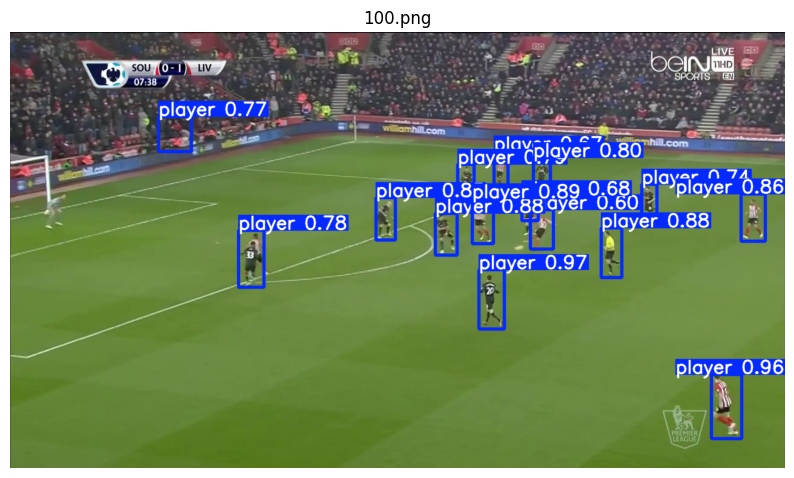

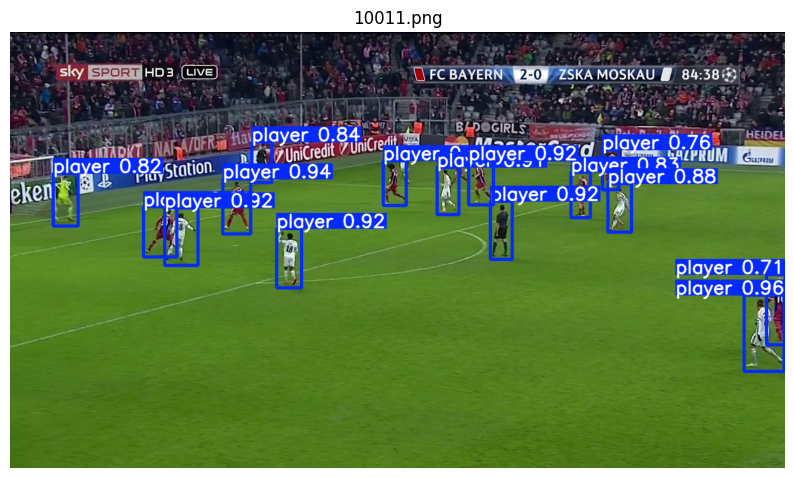

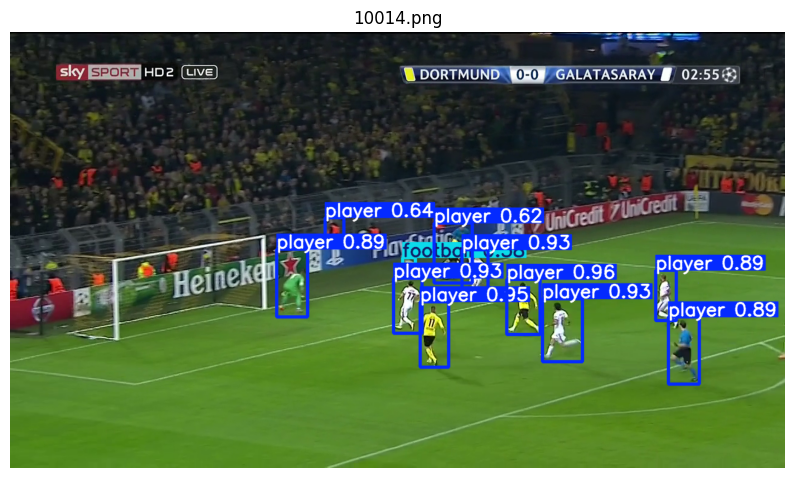

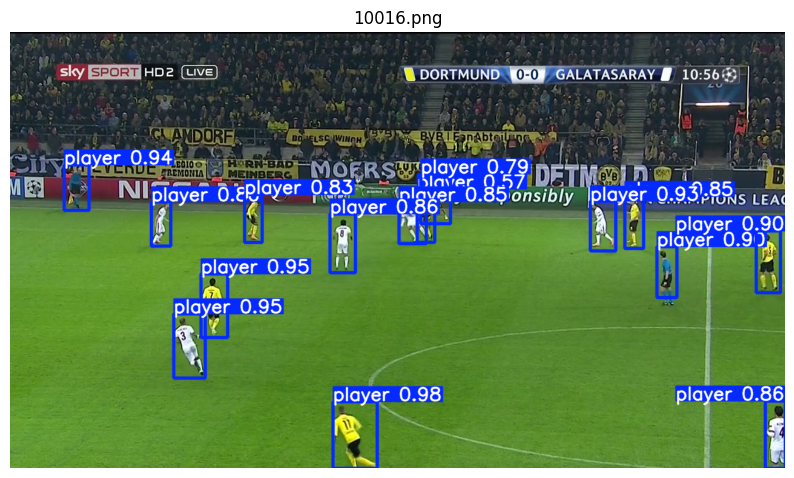

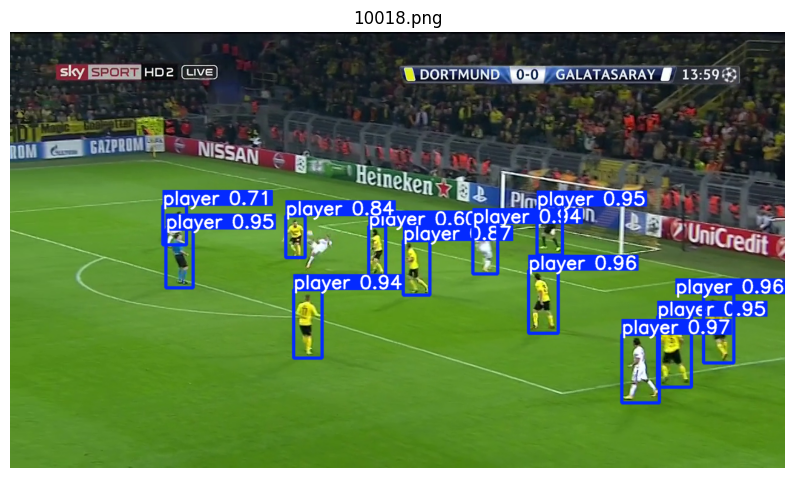

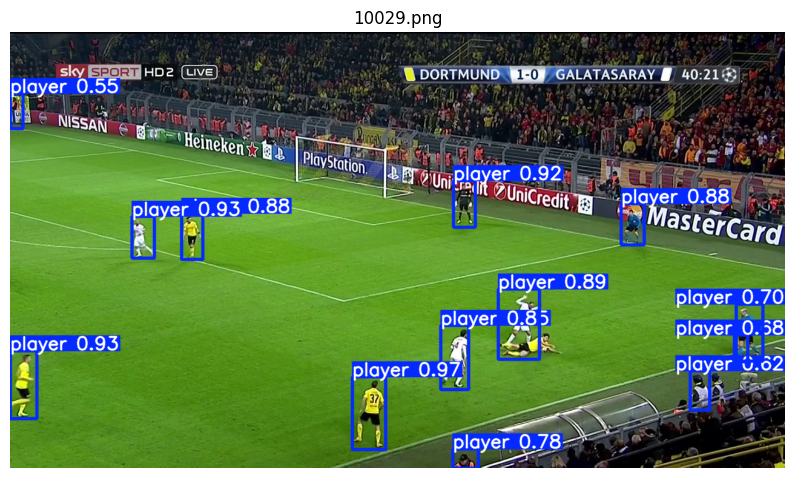

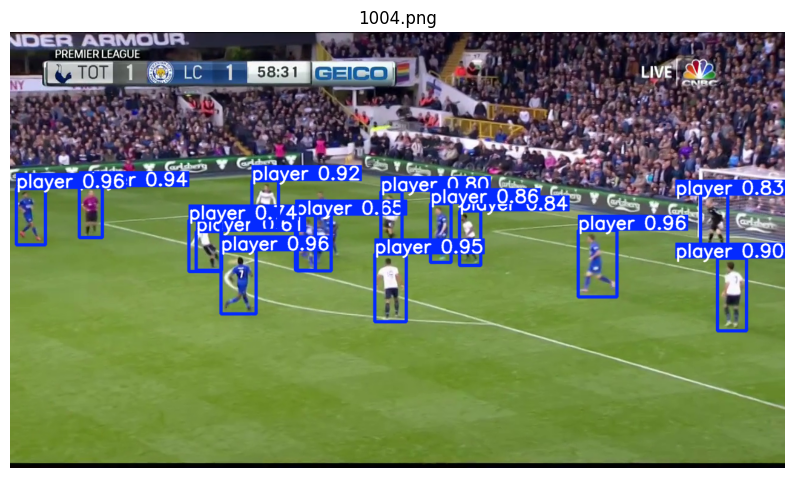

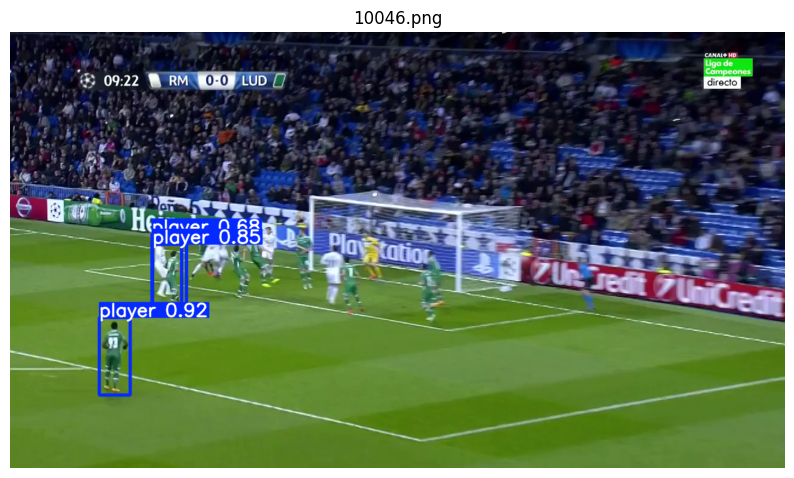

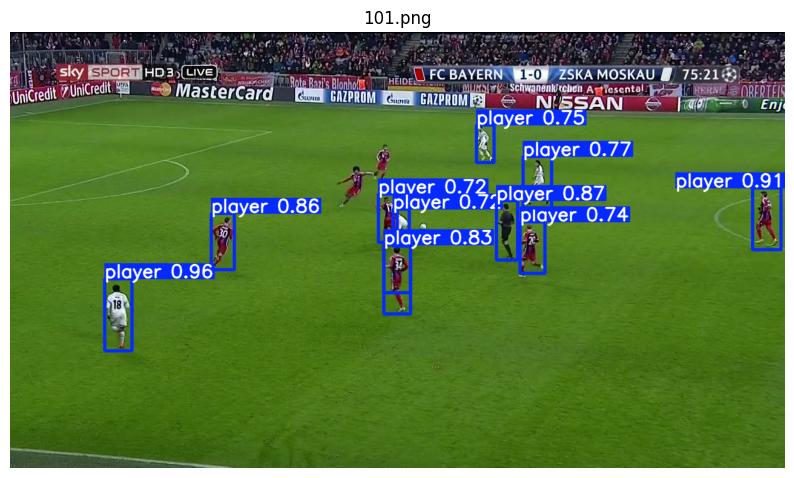

In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def display_images_in_directory(directory_path):
    # List all files in the directory
    files = os.listdir(directory_path)

    # Filter out only .png files
    image_files = [file for file in files if file.endswith('.png')]

    # Loop through each image file and display it
    for image_file in image_files:
        image_path = os.path.join(directory_path, image_file)
        img = mpimg.imread(image_path)
        plt.figure(figsize=(10, 10))
        plt.imshow(img)
        plt.title(image_file)
        plt.axis('off')  # Turn off axis
        plt.show()

# Example usage
directory_path = '/content/drive/MyDrive/yolov8/output/predict'
print("The output images:")
display_images_in_directory(directory_path)


In [ ]:
!pip install moviepy  # Install moviepy for video processing

from moviepy.editor import VideoFileClip

def convert_video_to_mp4(input_path, output_path):
    clip = VideoFileClip(input_path)
    clip.write_videofile(output_path, codec="libx264", audio_codec="aac")

# Example usage
input_video_path = video_path
output_video_path = '/content/drive/MyDrive/yolov8/output/predict2/converted_video.mp4'
convert_video_to_mp4(input_video_path, output_video_path)


Moviepy - Building video /content/drive/MyDrive/yolov8/output/predict2/converted_video.mp4.
Moviepy - Writing video /content/drive/MyDrive/yolov8/output/predict2/converted_video.mp4



Moviepy - Done !
Moviepy - video ready /content/drive/MyDrive/yolov8/output/predict2/converted_video.mp4


In [ ]:
from IPython.display import Video

def display_video(video_path):
    return Video(video_path, embed=True)

# Example usage
converted_video_path = output_video_path
display_video(converted_video_path)


In [ ]:
from IPython.display import Video

def display_video(video_path):
    return Video(video_path, embed=True)

# Example usage
video_path = '/content/drive/MyDrive/yolov8/output/predict2/08fd33_4.avi'
display_video(video_path)
